In [74]:
#upgrade pandas to 0.25.0
!pip install pandas==0.25.0

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.6/12.6 MB 1.1 MB/s eta 0:00:0000:0100:01
  Preparing metadata (setup.py) ... done
anceled
ERROR: Operation cancelled by user


In [2]:
import pandas as pd
import numpy as np
import datetime
from datetime import datetime
import matplotlib.pyplot as plt
import vectorbt as vbt

In [3]:
def timestamp_to_int(dt):  # takes a datetime object return timestamp in int
    return int(datetime.timestamp(dt) * 1000)

def timestampt_to_datetime(ts):  # takes a timestamp in int return datetime object
    return datetime.fromtimestamp(ts / 1000)


1H OI data cleaning

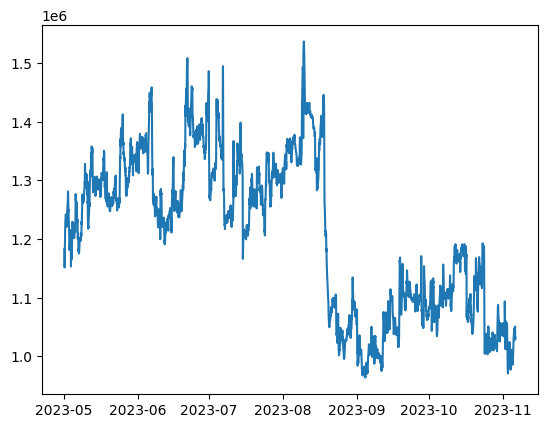

In [19]:
OI_data= pd.read_hdf("/Users/frank/Downloads/BTCUSDT_PERPETUAL.h5 2")

# Apply the conversion function to each element of the index
OI_data.index = OI_data.index.map(timestampt_to_datetime)

# Convert the 'sumOpenInterest' and 'sumOpenInterestValue' columns to float
OI_data['sumOpenInterest'] = OI_data['sumOpenInterest'].astype(float)
OI_data['sumOpenInterestValue'] = OI_data['sumOpenInterestValue'].astype(float)

OI_data = OI_data.iloc[:, 1:]
OI_data_1h = OI_data
OI_data_1h = OI_data_1h.resample('1H').sum()
OI_data_1h = OI_data_1h.iloc[:-1,:]
OI_data_1h.replace(to_replace=967697.241, value=1448073.270, inplace=True)
OI_data_1h.replace(to_replace=804176.767, value=1060116.690, inplace=True)

plt.plot(OI_data_1h['sumOpenInterest'])
#print(OI_data_1h.to_string())

15m OI data cleaning

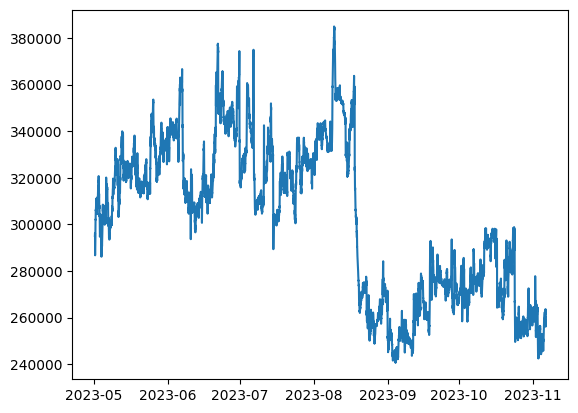

In [5]:
OI_data_15m = OI_data
OI_data_15m = OI_data_15m.resample('15T').sum()
OI_data_15m = OI_data_15m.iloc[:-1,:]
OI_data_15m.replace(to_replace=OI_data_15m.iloc[3501, 0], value=OI_data_15m.iloc[3500, 0], inplace=True)
OI_data_15m.replace(to_replace=OI_data_15m.iloc[3502, 0], value=OI_data_15m.iloc[3500, 0], inplace=True)
OI_data_15m.replace(to_replace=249314.980, value=373682.328, inplace=True)
OI_data_15m.replace(to_replace=OI_data_15m.iloc[12898, 0], value=OI_data_15m.iloc[12897, 0], inplace=True)
OI_data_15m.replace(to_replace=OI_data_15m.iloc[12899, 0], value=OI_data_15m.iloc[12897, 0], inplace=True)
plt.plot(OI_data_15m['sumOpenInterest'])
#print(OI_data_15m.to_string())

尋找離群值

In [6]:
from scipy import stats
z_scores = stats.zscore(OI_data_15m)
threshold = 2.5  # Adjust the threshold as needed
outliers = np.where(np.abs(z_scores) > threshold)[0]
print(outliers)
print(OI_data_15m.iloc[9614, 0])
print(OI_data_15m.iloc[6380, 0])


[ 3501  3502  6374  6380  6381  6382 12898 12899]
377059.704
373418.95900000003


generate OI MA

                        open     high      low    close
time                                                   
2023-01-01 00:00:00  16586.1  16591.7  16586.0  16587.7
2023-01-01 00:05:00  16587.7  16590.5  16586.9  16587.5
2023-01-01 00:10:00  16587.5  16588.5  16587.5  16588.4
2023-01-01 00:15:00  16588.4  16588.5  16577.3  16585.5
2023-01-01 00:20:00  16585.6  16597.1  16585.5  16597.0
2023-01-01 00:25:00  16597.1  16599.3  16597.0  16599.1
2023-01-01 00:30:00  16599.1  16599.3  16597.0  16597.0
2023-01-01 00:35:00  16597.0  16597.1  16590.7  16590.7
2023-01-01 00:40:00  16590.7  16594.5  16590.7  16593.6
2023-01-01 00:45:00  16593.7  16593.7  16592.3  16592.3
2023-01-01 00:50:00  16592.3  16608.8  16592.3  16608.7
2023-01-01 00:55:00  16608.8  16609.3  16596.0  16596.0
2023-01-01 01:00:00  16596.1  16600.1  16596.0  16598.2
2023-01-01 01:05:00  16598.2  16598.3  16596.2  16596.7
2023-01-01 01:10:00  16596.7  16596.8  16576.2  16578.6
2023-01-01 01:15:00  16578.7  16590.0  16571.4  

FigureWidget({
    'data': [{'close': array([16596. , 16573.4, 16571.7, ..., 34902.9, 34893.9, 34889.8]),
              'decreasing': {'line': {'color': '#d95f02'}},
              'high': array([16609.3, 16600.1, 16582.8, ..., 34947. , 34934. , 34897.2]),
              'increasing': {'line': {'color': '#1b9e76'}},
              'low': array([16577.3, 16565.9, 16566.2, ..., 34790.4, 34812. , 34878. ]),
              'name': 'OHLC',
              'open': array([16586.1, 16596.1, 16573.4, ..., 34838.5, 34902.9, 34893.9]),
              'type': 'ohlc',
              'uid': '543bff36-e164-49f5-bb41-2abc2ad75226',
              'x': array([datetime.datetime(2023, 1, 1, 0, 0),
                          datetime.datetime(2023, 1, 1, 1, 0),
                          datetime.datetime(2023, 1, 1, 2, 0), ...,
                          datetime.datetime(2023, 11, 5, 22, 0),
                          datetime.datetime(2023, 11, 5, 23, 0),
                          datetime.datetime(2023, 11, 6, 0, 

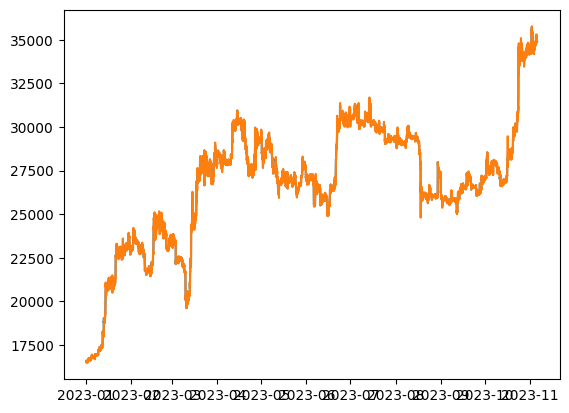

In [86]:
OHLC_data= pd.read_csv("/Users/frank/Downloads/BTCUSDT永續15m_1_1_2023_to_11_6_2023.csv")
OHLC_data = OHLC_data.iloc[:, 1:6]
OHLC_data['time'] = pd.to_datetime(OHLC_data['time'])
OHLC_data.set_index('time', inplace=True)
print(OHLC_data.to_string())
OHLC_data_15m = OHLC_data.iloc[:, 0:4]
OHLC_data_1h = OHLC_data.iloc[:, 0:4]
OHLC_data_15m = OHLC_data_15m.resample('15T').agg({'open': 'first', 
                                                    'high': 'max', 
                                                    'low': 'min', 
                                                    'close': 'last'})
OHLC_data_1h = OHLC_data_1h.resample('1H').agg({'open': 'first', 
                                                'high': 'max', 
                                                'low': 'min', 
                                                'close': 'last'})
plt.plot(OHLC_data_1h['close'])
plt.plot(OHLC_data_15m['close'])
OHLC_data_1h.vbt.ohlcv.plot()

In [83]:
OHLC_data_15m

,open,high,low,close
time,,,,
2023-01-01 00:00:00,16586.1,16591.7,16586.0,16588.4
2023-01-01 00:15:00,16588.4,16599.3,16577.3,16599.1
2023-01-01 00:30:00,16599.1,16599.3,16590.7,16593.6
2023-01-01 00:45:00,16593.7,16609.3,16592.3,16596.0
2023-01-01 01:00:00,16596.1,16600.1,16576.2,16578.6
...,...,...,...,...
2023-11-05 23:00:00,34902.9,34928.0,34869.6,34885.3
2023-11-05 23:15:00,34885.2,34926.9,34855.0,34921.6
2023-11-05 23:30:00,34921.7,34934.0,34871.0,34871.0


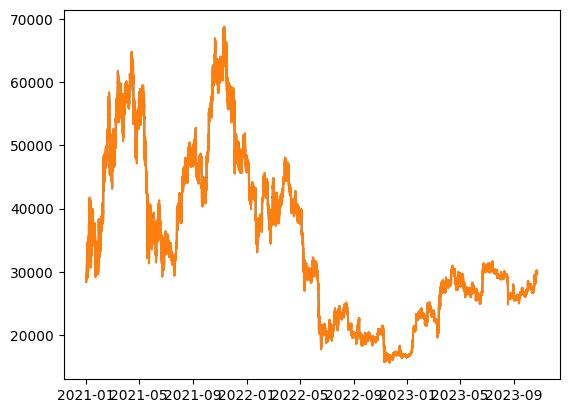

In [9]:
OHLC_data= pd.read_hdf("/Users/frank/Downloads/BTCUSDT_PERPETUAL.h5")
OHLC_data_15m = OHLC_data.iloc[:, 0:4]
OHLC_data_1h = OHLC_data.iloc[:, 0:4]
OHLC_data_15m = OHLC_data_15m.resample('15T').agg({'open': 'first', 
                                                    'high': 'max', 
                                                    'low': 'min', 
                                                    'close': 'last'})
OHLC_data_1h = OHLC_data_1h.resample('1H').agg({'open': 'first', 
                                                'high': 'max', 
                                                'low': 'min', 
                                                'close': 'last'})
plt.plot(OHLC_data_1h['close'])
plt.plot(OHLC_data_15m['close'])

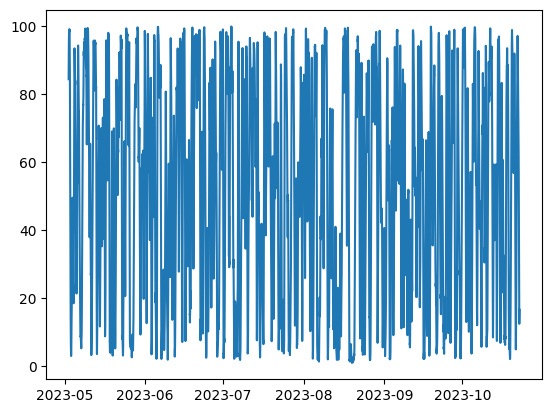

In [21]:
def generate_OIMA(data, fast, slow):
    data['MA_fast'] = data['sumOpenInterest'].rolling(fast).mean()
    data['MA_slow'] = data['sumOpenInterest'].rolling(slow).mean()
def OI_rank_pct(data, rolling_time, period):
    data['pct'] = data['sumOpenInterest'].rolling(period).rank(pct=True)*100
    data['OI_pct_MA'] = data['pct'].rolling(rolling_time).mean()
def generate_closeMA(data, fast, slow):
    data['MA_fast'] = data['close'].rolling(fast).mean()
    data['MA_slow'] = data['close'].rolling(slow).mean()
def generate_closeVWMA(data, period):
    data['VWMA'] = data['close'].rolling(period).apply(lambda x: np.average(x, weights=OHLC_data_15m.loc[x.index, '']))    
generate_closeMA(OHLC_data_15m, 16,48)
generate_OIMA(OI_data_15m, 24,72)
generate_OIMA(OI_data_1h, 24,72)
OI_rank_pct(OI_data_15m, 24, 96)
plt.plot(OI_data_15m['OI_pct_MA'])

In [22]:
def generate_RV(data, rolling_time, period):
    data.loc[:,'log_rtn_sq'] = np.square(np.log(data['close']/data['close'].shift(1)))
    data.loc[:, 'RV'] = np.sqrt(data['log_rtn_sq'].rolling(rolling_time).sum())
    data.loc[:, 'RV_pctrank'] = data['RV'].rolling(period).rank(pct=True)*100
    data.loc[:, 'RV_filter'] = np.where((data['RV_pctrank']>30) & (data['RV_pctrank']<70), 1, 0)
    
generate_RV(OHLC_data_1h, 24, 24*7)
generate_RV(OHLC_data_15m, 96, 96*7)
OHLC_data_15m



,open,high,low,close,MA_fast,MA_slow,log_rtn_sq,RV,RV_pctrank,RV_filter
time,,,,,,,,,,
2023-01-01 00:00:00,16586.1,16591.7,16586.0,16588.4,NaN,NaN,NaN,NaN,NaN,0
2023-01-01 00:15:00,16588.4,16599.3,16577.3,16599.1,NaN,NaN,4.157943e-07,NaN,NaN,0
2023-01-01 00:30:00,16599.1,16599.3,16590.7,16593.6,NaN,NaN,1.098247e-07,NaN,NaN,0
2023-01-01 00:45:00,16593.7,16609.3,16592.3,16596.0,NaN,NaN,2.091599e-08,NaN,NaN,0
2023-01-01 01:00:00,16596.1,16600.1,16576.2,16578.6,NaN,NaN,1.100391e-06,NaN,NaN,0
...,...,...,...,...,...,...,...,...,...,...
2023-11-05 23:00:00,34902.9,34928.0,34869.6,34885.3,35027.7750,35098.847917,2.544025e-07,0.014012,32.142857,1
2023-11-05 23:15:00,34885.2,34926.9,34855.0,34921.6,35013.6125,35095.339583,1.081625e-06,0.014048,32.142857,1
2023-11-05 23:30:00,34921.7,34934.0,34871.0,34871.0,34999.0250,35089.522917,2.102531e-06,0.014076,32.142857,1


In [23]:
def generate_BBand(data, mult, rolling_time):
    data.loc[:,'SMA'] = data['close'].rolling(rolling_time).mean()
    data.loc[:, 'upper'] = data['SMA'] + mult*data['close'].rolling(rolling_time).std()
    data.loc[:, 'lower'] = data['SMA'] - mult*data['close'].rolling(rolling_time).std()
generate_BBand(OHLC_data_15m, 2.5, 48)
generate_BBand(OHLC_data_1h, 2.5, 24)
OHLC_data_1h

,open,high,low,close,log_rtn_sq,RV,RV_pctrank,RV_filter,SMA,upper,lower
time,,,,,,,,,,,
2023-01-01 00:00:00,16586.1,16609.3,16577.3,16596.0,NaN,NaN,NaN,0,NaN,NaN,NaN
2023-01-01 01:00:00,16596.1,16600.1,16565.9,16573.4,1.856957e-06,NaN,NaN,0,NaN,NaN,NaN
2023-01-01 02:00:00,16573.4,16582.8,16566.2,16571.7,1.052251e-08,NaN,NaN,0,NaN,NaN,NaN
2023-01-01 03:00:00,16571.8,16585.0,16562.0,16564.3,1.994910e-07,NaN,NaN,0,NaN,NaN,NaN
2023-01-01 04:00:00,16564.3,16569.7,16562.0,16563.5,2.332678e-09,NaN,NaN,0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...
2023-11-05 20:00:00,35103.6,35187.0,35027.0,35096.0,4.565775e-08,0.015690,49.404762,1,34973.220833,35464.700244,34481.741423
2023-11-05 21:00:00,35096.1,35140.0,34758.0,34838.5,5.422948e-05,0.017263,65.476190,1,34979.154167,35453.902452,34504.405881
2023-11-05 22:00:00,34838.5,34947.0,34790.4,34902.9,3.410756e-06,0.017333,65.476190,1,34986.345833,35444.385507,34528.306160


調整資料日期

In [47]:
start = OI_data_1h.index[0]
end = OHLC_data_1h.index[-1]
print(start)
print(end)
OHLC_data_1h = OHLC_data_1h.loc[start:end, :]
OI_data_1h = OI_data_1h.loc[start:end, :]
print(OHLC_data_1h)
print(OI_data_1h)

start = OI_data_15m.index[0]
end = OI_data_15m.index[-1]
print(start)
print(end)
OHLC_data_15m = OHLC_data_15m.loc[start:end, :]
OI_data_15m = OI_data_15m.loc[start:end, :]
print(OHLC_data_15m)
print(OI_data_15m)

2023-05-01 08:00:00
2023-11-06 00:00:00
                        open     high      low    close
time                                                   
2023-05-01 08:00:00  29223.0  29325.5  29198.2  29303.3
2023-05-01 09:00:00  29303.3  29303.3  28333.0  28488.3
2023-05-01 10:00:00  28488.2  28666.0  28392.5  28535.0
2023-05-01 11:00:00  28535.0  28584.3  28420.0  28545.6
2023-05-01 12:00:00  28545.6  28577.3  28470.1  28543.7
...                      ...      ...      ...      ...
2023-11-05 20:00:00  35103.6  35187.0  35027.0  35096.0
2023-11-05 21:00:00  35096.1  35140.0  34758.0  34838.5
2023-11-05 22:00:00  34838.5  34947.0  34790.4  34902.9
2023-11-05 23:00:00  34902.9  34934.0  34812.0  34893.9
2023-11-06 00:00:00  34893.9  34897.2  34878.0  34889.8

[4529 rows x 4 columns]
                     sumOpenInterest  sumOpenInterestValue       MA_fast  \
timestamp                                                                  
2023-05-01 08:00:00      1183072.482          3.464206e

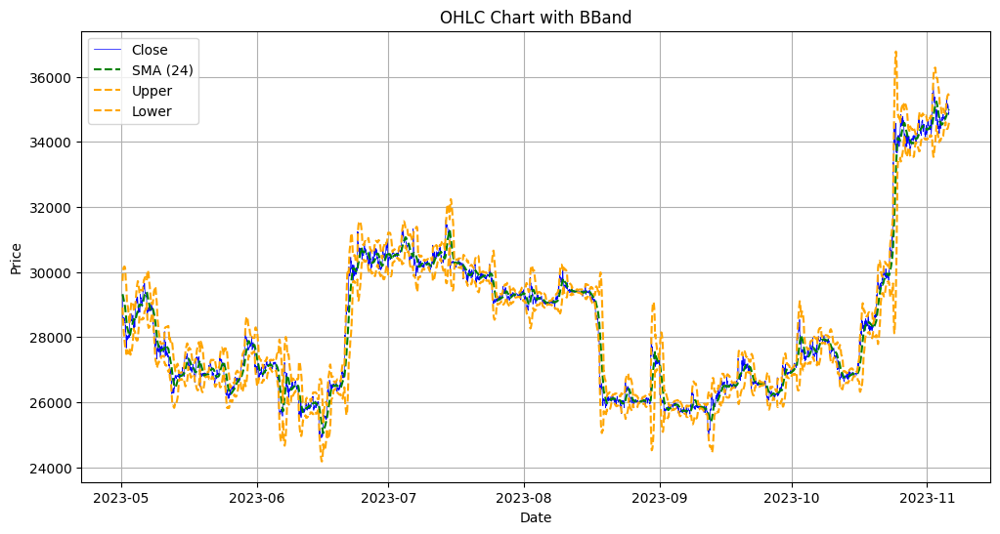

In [38]:
def plot_OHLC(df, rolling_time):   
    plt.figure(figsize=(12, 6))

    # Plot OHLC bars
    #plt.bar(df.index, df['high'] - df['low'], bottom=df['low'], color='black', width=0.2, align='center', label='OHLC')

    # Plot Closing prices as a line
    plt.plot(df.index, df['close'], color='blue', linewidth=0.5, label='Close')

    # Plot SMA and EMA as lines
    plt.plot(df.index, df['SMA'], color='green', linestyle='--', label=f'SMA ({rolling_time})')
    plt.plot(df.index, df['upper'], color='orange', linestyle='--', label=f'Upper')
    plt.plot(df.index, df['lower'], color='orange', linestyle='--', label=f'Lower')

    # Customize the chart
    plt.title('OHLC Chart with BBand')
    plt.xlabel('Date')
    plt.ylabel('Price')
    plt.legend()
    plt.grid(True)

    # Show the chart
    plt.show()
    
plot_OHLC(OHLC_data_1h.loc[start:, :], 24) 


In [39]:
def crossover(over,down):
    a1 = over
    b1 = down
    a2 = a1.shift(1)
    b2 = b1.shift(1)
    crossover =  (a1>a2) & (a1>b1) & (b2>a2)
    return crossover
# 死亡交叉
def crossunder(down,over):
    a1 = down
    b1 = over
    a2 = a1.shift(1)
    b2 = b1.shift(1)
    crossdown =  (a1<a2) & (a1<b1) & (b2<a2)
    return crossdown

In [28]:
def crossover2(over,down):
    a1 = over
    b1 = down
    a2 = a1.shift(1)
    crossover =  (a1>a2) & (a1>b1) & (b1>a2)
    return crossover
# 死亡交叉
def crossunder2(down,over):
    a1 = down
    b1 = over
    a2 = a1.shift(1)
    crossdown =  (a1<a2) & (a1<b1) & (b1<a2)
    return crossdown

define entry and exit

In [42]:
signal = pd.DataFrame()
signal['long_entry'] = np.where((OHLC_data_1h['close']>OHLC_data_1h['upper']) & (OI_data_1h['MA_fast']>OI_data_1h['MA_slow']) & (OHLC_data_1h['RV_filter']), 1,0)
signal['long_exit'] = np.where(crossunder(OI_data_1h['MA_fast'],OI_data_1h['MA_slow']), 1,0)
signal['short_entry'] = np.where((OHLC_data_1h['close']<OHLC_data_1h['lower']) & (OI_data_1h['MA_fast']>OI_data_1h['MA_slow']) & (OHLC_data_1h['RV_filter']), -1,0)
signal['short_exit'] = np.where(crossunder(OI_data_1h['MA_fast'],OI_data_1h['MA_slow']), 1,0)
signal2 = pd.DataFrame()
signal2['long_entry'] = np.where((OHLC_data_1h['close']>OHLC_data_1h['upper']) & (OI_data_1h['MA_fast']>OI_data_1h['MA_slow']), 1,0)
signal2['long_exit'] = np.where(crossunder(OI_data_1h['MA_fast'],OI_data_1h['MA_slow']), 1,0)
signal2['short_entry'] = np.where((OHLC_data_1h['close']<OHLC_data_1h['lower']) & (OI_data_1h['MA_fast']>OI_data_1h['MA_slow']), -1,0)
signal2['short_exit'] = np.where(crossunder(OI_data_1h['MA_fast'],OI_data_1h['MA_slow']), 1,0)
signal3 = pd.DataFrame()
signal3['long_entry'] = np.where((OHLC_data_15m['close']>OHLC_data_15m['upper']) & (OI_data_15m['MA_fast']>OI_data_15m['MA_slow']) & (OHLC_data_15m['RV_filter']), 1,0)
signal3['long_exit'] = np.where(crossunder(OI_data_15m['MA_fast'],OI_data_15m['MA_slow']), 1,0)
signal3['short_entry'] = np.where((OHLC_data_15m['close']<OHLC_data_15m['lower']) & (OI_data_15m['MA_fast']>OI_data_15m['MA_slow']) & (OHLC_data_15m['RV_filter']), -1,0)
signal3['short_exit'] = np.where(crossunder(OI_data_15m['MA_fast'],OI_data_15m['MA_slow']), 1,0)
signal4 = pd.DataFrame()
signal4['long_entry'] = np.where((crossover2(OI_data_15m['OI_pct_MA'], 30)) & (OHLC_data_15m['MA_fast']>OHLC_data_15m['MA_slow']) & (OHLC_data_15m['RV_filter']), 1,0)
signal4['long_exit'] = np.where((crossunder2(OI_data_15m['OI_pct_MA'], 30)), 1,0)
signal4['short_entry'] = np.where((crossover2(OI_data_15m['OI_pct_MA'], 30)) & (OHLC_data_15m['MA_fast']<OHLC_data_15m['MA_slow']) & (OHLC_data_15m['RV_filter']), -1,0)
signal4['short_exit'] = np.where((crossunder2(OI_data_15m['OI_pct_MA'], 30)), 1,0)

In [54]:
def back_test(data, signal):
    pf = vbt.Portfolio.from_signals(data['close'],
                                    entries=signal['long_entry'],
                                    exits=signal['long_exit'],
                                    short_entries=signal['short_entry'],
                                    short_exits=signal['short_exit'],
                                    fees=0.00075,
                                    )
    print(pf.stats())
    fig = pf.plot(subplots=['cum_returns','drawdowns', 'orders', 'trade_pnl'])
    fig.show()
back_test(OHLC_data_1h, signal) #BBand+OI_exit+RV(1h)
back_test(OHLC_data_1h, signal2) #BBand+OI_exit(1h)
back_test(OHLC_data_15m, signal3) #BBand+OI_exit+RV(15m)
back_test(OHLC_data_15m, signal4) #OI_pct_ma+RV(15m) 該死的overfit

Start                         2023-05-01 08:00:00
End                           2023-11-06 00:00:00
Period                          188 days 17:00:00
Start Value                                 100.0
End Value                              122.784595
Total Return [%]                        22.784595
Benchmark Return [%]                    19.064406
Max Gross Exposure [%]                      100.0
Total Fees Paid                          3.969964
Max Drawdown [%]                         8.392321
Max Drawdown Duration            67 days 00:00:00
Total Trades                                   24
Total Closed Trades                            24
Total Open Trades                               0
Open Trade PnL                                0.0
Win Rate [%]                            29.166667
Best Trade [%]                          12.471746
Worst Trade [%]                         -2.397943
Avg Winning Trade [%]                    5.411318
Avg Losing Trade [%]                    -0.906252


Start                         2023-05-01 08:00:00
End                           2023-11-06 00:00:00
Period                          188 days 17:00:00
Start Value                                 100.0
End Value                              121.790262
Total Return [%]                        21.790262
Benchmark Return [%]                    19.064406
Max Gross Exposure [%]                      100.0
Total Fees Paid                          6.963439
Max Drawdown [%]                        13.189851
Max Drawdown Duration            68 days 13:00:00
Total Trades                                   45
Total Closed Trades                            45
Total Open Trades                               0
Open Trade PnL                                0.0
Win Rate [%]                            31.111111
Best Trade [%]                          15.851514
Worst Trade [%]                         -2.862512
Avg Winning Trade [%]                    4.048578
Avg Losing Trade [%]                    -1.102218


Start                         2023-05-01 08:00:00
End                           2023-10-22 23:45:00
Period                          174 days 16:00:00
Start Value                                 100.0
End Value                              116.382641
Total Return [%]                        16.382641
Benchmark Return [%]                     1.825428
Max Gross Exposure [%]                      100.0
Total Fees Paid                         11.514555
Max Drawdown [%]                        14.134744
Max Drawdown Duration           120 days 23:45:00
Total Trades                                   71
Total Closed Trades                            71
Total Open Trades                               0
Open Trade PnL                                0.0
Win Rate [%]                            38.028169
Best Trade [%]                          11.487283
Worst Trade [%]                         -2.173214
Avg Winning Trade [%]                    1.729215
Avg Losing Trade [%]                    -0.688813


Start                         2023-05-01 08:00:00
End                           2023-10-22 23:45:00
Period                          174 days 16:00:00
Start Value                                 100.0
End Value                              114.919822
Total Return [%]                        14.919822
Benchmark Return [%]                     1.825428
Max Gross Exposure [%]                      100.0
Total Fees Paid                          7.334627
Max Drawdown [%]                        12.892959
Max Drawdown Duration            70 days 05:45:00
Total Trades                                   49
Total Closed Trades                            49
Total Open Trades                               0
Open Trade PnL                                0.0
Win Rate [%]                            42.857143
Best Trade [%]                           9.316734
Worst Trade [%]                          -4.88572
Avg Winning Trade [%]                     2.03928
Avg Losing Trade [%]                    -0.989057
